# Data Cleanning

In [83]:
import pandas as pd
import numpy as np
import os

# print(os.getcwd())
df = pd.read_csv("./uber.csv")
original_row, original_col = df.shape

print(f"The original has {original_row} rows")
print(f"The original has {original_col} columns")


The original has 200000 rows
The original has 9 columns


### Drop zero rows

In [84]:
# get the column names
column_names = list(df.columns)[1:]
df = df[(df.pickup_latitude != 0) & (df.dropoff_latitude != 0) |
        (df.pickup_longitude != 0) & (df.dropoff_longitude != 0)]

drop_zero_row, drop_zero_col = df.shape
print("------- Dropped zero rows -------")
print(f"The original has {drop_zero_row} rows")
print(f"The original has {drop_zero_col} columns")


------- Dropped zero rows -------
The original has 196052 rows
The original has 9 columns


In [85]:
display(df.describe())

,Unnamed: 0,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,1.960520e+05,196052.000000,196052.000000,196052.000000,196051.000000,196051.000000,196052.000000
mean,2.771247e+07,11.343132,-73.926665,40.704972,-73.913342,40.687971,1.685242
std,1.600912e+07,9.799482,5.472047,5.428889,8.534116,3.997262,1.388159
min,1.000000e+00,-52.000000,-1340.648410,-74.015515,-3356.666300,-881.985513,0.000000
25%,1.383185e+07,6.000000,-73.992268,40.736394,-73.991592,40.735263,1.000000
50%,2.774976e+07,8.500000,-73.982101,40.753287,-73.980521,40.753725,1.000000
75%,4.154486e+07,12.500000,-73.968311,40.767542,-73.965314,40.768326,2.000000
max,5.542357e+07,499.000000,57.418457,1644.421482,1153.572603,872.697628,208.000000


### Translate pickup datetime

In [86]:
df.pickup_datetime = pd.to_datetime(df.pickup_datetime)

df['year'] = df.pickup_datetime.dt.year
df['month'] = df.pickup_datetime.dt.month
df['weekday'] = df.pickup_datetime.dt.weekday
df['hour'] = df.pickup_datetime.dt.hour

In [87]:
display(df.describe())

,Unnamed: 0,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,weekday,hour
count,1.960520e+05,196052.000000,196052.000000,196052.000000,196051.000000,196051.000000,196052.000000,196052.000000,196052.000000,196052.000000,196052.000000
mean,2.771247e+07,11.343132,-73.926665,40.704972,-73.913342,40.687971,1.685242,2011.739574,6.282272,3.048497,13.490681
std,1.600912e+07,9.799482,5.472047,5.428889,8.534116,3.997262,1.388159,1.858799,3.439803,1.946999,6.514398
min,1.000000e+00,-52.000000,-1340.648410,-74.015515,-3356.666300,-881.985513,0.000000,2009.000000,1.000000,0.000000,0.000000
25%,1.383185e+07,6.000000,-73.992268,40.736394,-73.991592,40.735263,1.000000,2010.000000,3.000000,1.000000,9.000000
50%,2.774976e+07,8.500000,-73.982101,40.753287,-73.980521,40.753725,1.000000,2012.000000,6.000000,3.000000,14.000000
75%,4.154486e+07,12.500000,-73.968311,40.767542,-73.965314,40.768326,2.000000,2013.000000,9.000000,5.000000,19.000000
max,5.542357e+07,499.000000,57.418457,1644.421482,1153.572603,872.697628,208.000000,2015.000000,12.000000,6.000000,23.000000


### Compute travel distance

In [88]:
def convert_longlat_to_mile(lat1, lon1, lat2, lon2):
    # approximate radius of Earth in km
    R = 6371.0

    # latitude and longitude coordinates of two points
    lat1 = np.radians(lat1)
    lon1 = np.radians(lon1)
    lat2 = np.radians(lat2)
    lon2 = np.radians(lon2)

    # calculate the differences in latitude and longitude
    dlat = lat2 - lat1
    dlon = lon2 - lon1

    # calculate the distance using the Haversine formula (in miles)
    a = np.sin(dlat / 2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    distance = R * c* 0.621371
    
    return distance

### Add "distance" column to the dataframe

In [89]:
df['distance'] = convert_longlat_to_mile(df['pickup_latitude'], df['pickup_longitude'], df['dropoff_latitude'], df['dropoff_longitude'])
df['fare_per_mile'] = df['fare_amount'] / df['distance']
df['fare_per_mile'] = df['fare_per_mile'].replace([np.inf, -np.inf], np.nan)
df = df.dropna()

### Drop outliers

In [90]:
# Drop latitude & longitude outliers
df = df[(df.pickup_latitude<90) & (df.dropoff_latitude<90) &
        (df.pickup_latitude>-90) & (df.dropoff_latitude>-90) &
        (df.pickup_longitude<180) & (df.dropoff_longitude<180) &
        (df.pickup_longitude>-180) & (df.dropoff_longitude>-180)]

# Drop distance, fare amount, passenger count outliers
df = df.drop(df[(df.distance < 1) | (df.distance >= 300)].index)
df = df.drop(df[((df.fare_amount == max(df.fare_amount)) | (df.fare_amount < 2.5))].index)
df = df.drop(df[(df.passenger_count == 208) | (df.passenger_count < 1)].index)

cleaned_row, cleaned_col = df.shape

print("------- Cleaned lattitude & longitude -------")
print(f"The cleaned data has {cleaned_row} rows")
print(f"The cleaned data has {cleaned_col} columns")


------- Cleaned lattitude & longitude -------
The cleaned data has 125228 rows
The cleaned data has 15 columns


In [91]:
display(df.describe())

,Unnamed: 0,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,weekday,hour,distance,fare_per_mile
count,1.252280e+05,125228.000000,125228.000000,125228.000000,125228.000000,125228.000000,125228.000000,125228.000000,125228.000000,125228.000000,125228.000000,125228.000000,125228.000000
mean,2.772108e+07,14.200495,-73.923052,40.699907,-73.921592,40.700240,1.693894,2011.756324,6.308909,3.091577,13.446170,2.900945,5.502157
std,1.600204e+07,10.496914,2.391276,2.384398,2.391425,2.384956,1.303372,1.852036,3.417383,1.958414,6.743832,2.961223,1.942326
min,1.000000e+00,2.500000,-77.316665,-74.015515,-75.458979,-74.015750,1.000000,2009.000000,1.000000,0.000000,0.000000,1.000014,0.054685
25%,1.385539e+07,8.100000,-73.992677,40.733955,-73.991644,40.731850,1.000000,2010.000000,3.000000,1.000000,9.000000,1.394419,4.307923
50%,2.776461e+07,10.900000,-73.981987,40.752788,-73.979487,40.753391,1.000000,2012.000000,6.000000,3.000000,14.000000,1.997538,5.200581
75%,4.155530e+07,15.700000,-73.967184,40.768631,-73.961496,40.769988,2.000000,2013.000000,9.000000,5.000000,19.000000,3.285407,6.294245
max,5.542290e+07,220.000000,40.806012,42.478467,40.828672,42.464187,6.000000,2015.000000,12.000000,6.000000,23.000000,228.317893,121.481087


### Save cleaned dataset

In [92]:
current_path = os.getcwd()
output_path = os.path.join(current_path, "cleaned_uber.csv")
df.columns.values[0] = 'Trip Index'
df.to_csv(output_path, index=False)

# Use cleaned Dataset

In [79]:
import pandas as pd
import numpy as np
import os

# print(os.getcwd())
df = pd.read_csv("./sample_data/cleaned_uber.csv")
original_row, original_col = df.shape

print(f"The cleand data has {original_row} rows")
print(f"The cleand data has {original_col} columns")


The cleand data has 193994 rows
The cleand data has 15 columns


In [80]:
display(df.describe())

,Trip Index,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,weekday,hour,distance,fare_per_mile
count,1.939940e+05,193994.000000,193994.000000,193994.000000,193994.000000,193994.000000,193994.000000,193994.000000,193994.000000,193994.000000,193994.000000,193994.000000,1.939940e+05
mean,2.770756e+07,11.345562,-73.901881,40.687111,-73.900954,40.686512,1.685031,2011.745090,6.281117,3.048976,13.488149,3.231289,1.370226e+02
std,1.600772e+07,9.735701,2.801912,2.639876,2.797535,2.645340,1.388588,1.859883,3.440422,1.946673,6.515338,65.064110,7.447392e+03
min,1.000000e+00,-52.000000,-93.824668,-74.015515,-75.458979,-74.015750,0.000000,2009.000000,1.000000,0.000000,0.000000,0.000052,-4.154394e+03
25%,1.382766e+07,6.000000,-73.992279,40.736434,-73.991599,40.735300,1.000000,2010.000000,3.000000,1.000000,9.000000,0.795494,4.777307e+00
50%,2.773567e+07,8.500000,-73.982127,40.753290,-73.980561,40.753733,1.000000,2012.000000,6.000000,3.000000,14.000000,1.354952,6.148826e+00
75%,4.153735e+07,12.500000,-73.968447,40.767533,-73.965495,40.768326,2.000000,2013.000000,9.000000,5.000000,19.000000,2.450132,8.130671e+00
max,5.542357e+07,499.000000,40.808425,48.018760,40.831932,45.031598,208.000000,2015.000000,12.000000,6.000000,23.000000,5411.043487,1.075018e+06


# Data exploration

hour             12.000000
fare_per_mile     5.993266
Name: 12, dtype: float64


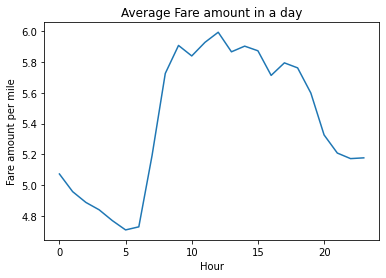

In [96]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


groupby_hour = df.groupby('hour')['fare_per_mile'].mean().reset_index()
groupby_hour.sort_values(by='fare_per_mile',ascending=False,inplace=True)
print(groupby_hour.iloc[0])

# sns.lineplot(x = df['hour'], y = df['fare_per_mile'], data = groupby_hour) # plot the data
sns.lineplot(x = 'hour', y = 'fare_per_mile', data = groupby_hour) # plot the data
plt.title("Average Fare amount in a day")
plt.xlabel("Hour")
plt.ylabel("Fare amount per mile")
plt.show() # show the plot

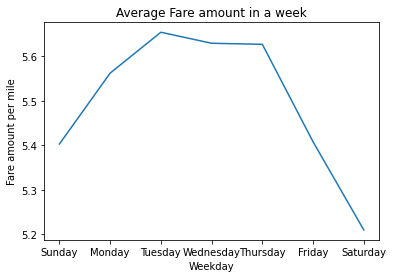

In [97]:

groupby_week = df.groupby('weekday')['fare_per_mile'].mean().reset_index()

day_map = {0: 'Sunday', 1: 'Monday', 2: 'Tuesday', 3: 'Wednesday', 4: 'Thursday', 5: 'Friday', 6: 'Saturday'}
groupby_week['weekday'] = groupby_week['weekday'].replace(day_map)
sns.lineplot(x = 'weekday', y ='fare_per_mile', data = groupby_week) # plot the data
plt.title("Average Fare amount in a week")
plt.xlabel("Weekday")
plt.ylabel("Fare amount per mile")
plt.show() # show the plot

   passenger_count  fare_per_mile  counted
0                1       5.492740    86397
1                2       5.509331    19027
4                5       5.432512     8763
2                3       5.534032     5627
3                4       5.579156     2754
5                6       5.838985     2660


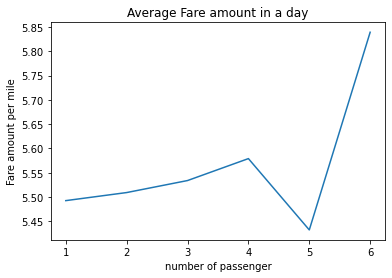

In [99]:
groupby_num_passenger = df.groupby('passenger_count',as_index=False).agg(fare_per_mile = ('fare_per_mile','mean'),counted = ("key", "count"))
temp = groupby_num_passenger.sort_values(by='counted',ascending=False,inplace=False)
print(temp)

sns.lineplot(x = 'passenger_count', y ='fare_per_mile', data = groupby_num_passenger) # plot the data
plt.title("Average Fare amount in a day")
plt.xlabel("number of passenger")
plt.ylabel("Fare amount per mile")
plt.show() # show the plot

<ipython-input-100-df02346112b0>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Index(['hour', 'fare_per_mile', 'counted', 'distance', 'fare_amount'], dtype='object')


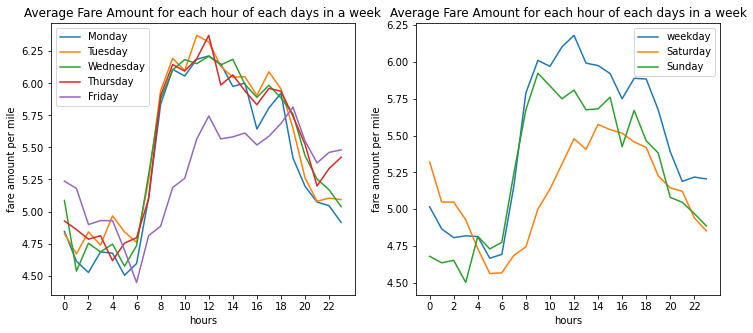

In [100]:

fares = df[df["passenger_count"] ==1]
fares['weekday'] = fares['weekday'].replace(day_map)
days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

for day in days:
    mask = fares["weekday"] == day
    fares_day = fares[mask].groupby("hour",as_index=False).agg(fare_per_mile = ("fare_per_mile", "mean"), counted = ("key", "count"), distance = ("distance", "mean"), fare_amount = ("fare_amount", "mean"))
    exec(f"fares_{day.lower()} = fares_day")

fares_weekday = fares[(fares["weekday"] != "Saturday") & (fares["weekday"] != "Sunday")].groupby("hour", as_index = False).agg(fare_per_mile = ("fare_per_mile", "mean"), counted = ("key", "count"), distance = ("distance", "mean"),fare_amount = ("fare_amount", "mean"))
fares_weekday["counted"] = fares_weekday["counted"] /5 

print(fares_monday.columns)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
ax1.plot(fares_monday.hour, fares_monday.fare_per_mile, label='Monday')
ax1.plot(fares_monday.hour, fares_tuesday.fare_per_mile, label='Tuesday')
ax1.plot(fares_monday.hour, fares_wednesday.fare_per_mile, label='Wednesday')
ax1.plot(fares_monday.hour, fares_thursday.fare_per_mile, label='Thursday')
ax1.plot(fares_monday.hour, fares_friday.fare_per_mile, label='Friday')
ax1.set_title('Average Fare Amount for each hour of each days in a week')
ax1.set_xlabel('hours')
ax1.set_ylabel('fare amount per mile')
ax1.set_xticks(np.arange(0, 24, 2))
ax1.set_xticklabels(np.arange(0, 24, 2))
ax1.legend()


ax2.plot(fares_monday.hour, fares_weekday.fare_per_mile, label='weekday')
ax2.plot(fares_monday.hour, fares_saturday.fare_per_mile, label='Saturday')
ax2.plot(fares_monday.hour, fares_sunday.fare_per_mile, label='Sunday')
ax2.set_title('Average Fare Amount for each hour of each days in a week')
ax2.set_xlabel('hours')
ax2.set_ylabel('fare amount per mile')
ax2.set_xticks(np.arange(0, 24, 2))
ax2.set_xticklabels(np.arange(0, 24, 2))
ax2.legend()
# fares_weekday = fares[(fares["pickup_day"] != "Saturday") & (fares["pickup_day"] != "Sunday")].groupby("hour", as_index = False).agg(fare_per_mile = ("fare_per_mile", "mean"), counted = ("key", "count"), distance = ("distance", "mean"),fare_amount = ("fare_amount", "mean"))

# Data visualization

In [101]:
!pip install plotly

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### Pickuo & Drop-off Heatmap

In [102]:
pick_latitudes=df['pickup_latitude'].to_list()
pick_longitudes=df['pickup_longitude'].to_list()
dropoff_latitudes=df['dropoff_latitude'].to_list()
dropoff_longitudes=df['dropoff_longitude'].to_list()

points=[]
long=[]
lat=[]

m = folium.Map(location=[40.7589,-73.9851], zoom_start=12)

for i in range(len(dropoff_latitudes)):
  long.append((dropoff_latitudes[i],dropoff_longitudes[i]))
  points.append(list(long[i]))

for i in range(len(pick_latitudes)):
    lat.append((pick_latitudes[i],pick_longitudes[i]))
    points.append(list(lat[i])) 
    folium.Marker(location=[pick_latitudes[i], pick_longitudes[i]], 
                  icon=folium.Icon(color='blue')).add_to(m)

In [103]:
import folium
from folium import plugins

# Generate heatmap for Pickup & Drop-off locations
m=folium.Map(location=[40.767937,-73.982155 ])
plugins.HeatMap(points).add_to(m)

m

### Pickup location

In [104]:
pickup_map = folium.Map(location=[40.767937,-73.982155 ],tiles='OpenStreetMap',zoom_start=12)
for each in df[:10000].iterrows():
    folium.CircleMarker(
                        [each[1]['pickup_latitude'],each[1]['pickup_longitude']],
                        radius=1,
                        color='#cc1d1d',
                        popup=str(each[1]['pickup_latitude'])+','+str(each[1]['pickup_longitude']),
                        fill_color='#cc1d1d'
                       ).add_to(pickup_map)

pickup_map

### Dropoff location

In [105]:
dropoff_map = folium.Map(location=[40.767937,-73.982155 ],tiles='OpenStreetMap',zoom_start=12)
for each in df[:10000].iterrows():
    folium.CircleMarker(
                        [each[1]['pickup_latitude'],each[1]['pickup_longitude']],
                        radius=1,
                        color='#14457a',
                        popup=str(each[1]['dropoff_latitude'])+','+str(each[1]['dropoff_longitude']),
                        fill_color='#14457a'
                       ).add_to(dropoff_map)
dropoff_map

### Create a map with the pickup locations and lines to the corresponding dropoff locations

In [106]:
# Create a map with the pickup locations and lines to the corresponding dropoff locations

connection_map = folium.Map(location=[40.767937, -73.982155], tiles='OpenStreetMap', zoom_start=12)
for index, row in df[:50].iterrows():
    # Add a marker for the pickup location
    pickup_marker = folium.CircleMarker(location=[row['pickup_latitude'], row['pickup_longitude']],
                                         radius=1,
                                         color='#cc1d1d',
                                         popup=f"Pickup: ({row['pickup_latitude']}, {row['pickup_longitude']})",
                                         fill_color='#cc1d1d')
    pickup_marker.add_to(pickup_map)
    
    # Add a marker for the dropoff location
    dropoff_marker = folium.CircleMarker(location=[row['dropoff_latitude'], row['dropoff_longitude']],
                                          radius=1,
                                          color='#14457a',
                                          popup=f"Dropoff: ({row['dropoff_latitude']}, {row['dropoff_longitude']})",
                                          fill_color='#14457a')
    dropoff_marker.add_to(pickup_map)
    
    # Add a line connecting the pickup and dropoff locations
    folium.PolyLine(locations=[[row['pickup_latitude'], row['pickup_longitude']],
                               [row['dropoff_latitude'], row['dropoff_longitude']]],
                    color='#3c0f8a', weight=3).add_to(connection_map)

connection_map

In [107]:
# Create a map with the pickup locations and lines to the corresponding dropoff locations
connection_map = folium.Map(location=[40.767937, -73.982155], tiles='OpenStreetMap', zoom_start=12)
for index, row in df[:10000].iterrows():
    # Add a marker for the pickup location
    pickup_marker = folium.CircleMarker(location=[row['pickup_latitude'], row['pickup_longitude']],
                                         radius=1,
                                         color='#cc1d1d',
                                         popup=f"Pickup: ({row['pickup_latitude']}, {row['pickup_longitude']})",
                                         fill_color='#cc1d1d')
    pickup_marker.add_to(pickup_map)
    
    # Add a marker for the dropoff location
    dropoff_marker = folium.CircleMarker(location=[row['dropoff_latitude'], row['dropoff_longitude']],
                                          radius=1,
                                          color='#14457a',
                                          popup=f"Dropoff: ({row['dropoff_latitude']}, {row['dropoff_longitude']})",
                                          fill_color='#14457a')
    dropoff_marker.add_to(pickup_map)
    
    # Add a line connecting the pickup and dropoff locations
    folium.PolyLine(locations=[[row['pickup_latitude'], row['pickup_longitude']],
                               [row['dropoff_latitude'], row['dropoff_longitude']]],
                    color='#3c0f8a', weight=1).add_to(connection_map)

connection_map